
[Holzapfel and Stylianou](https://www.ics.forth.gr/netlab/data/J13.pdf)


In [1]:
from __future__ import print_function

In [2]:
import librosa
import numpy as np
import scipy
import matplotlib.pyplot as plt
%matplotlib inline
from IPython.display import Audio

In [21]:
y, sr = librosa.load('audio/BFJazz_-_Stargazer_from_Texas.mp3', sr=44100)
#y, sr = librosa.load('/home/bmcfee/working/Battles - Tonto-it1CCNCHPc0.mp3', sr=44100, duration=240, offset=240)

In [22]:
# Compute a log-CQT for visualization
C = librosa.logamplitude(librosa.cqt(y=y, sr=sr, bins_per_octave=12*3, n_bins=7*12*3, real=False)**2, ref_power=np.max)

/home/bmcfee/miniconda/envs/py35/lib/python3.5/site-packages/numpy/core/numeric.py:482: VisibleDeprecationWarning: using a non-integer number instead of an integer will result in an error in the future
  return array(a, dtype, copy=False, order=order)


In [23]:
# We'll use a superflux-style onset strength envelope
oenv = librosa.onset.onset_strength(y=y, sr=sr, lag=2, max_size=5)

In [24]:
# Get the tempogram
tgram = librosa.feature.tempogram(onset_envelope=oenv, sr=sr, win_length=512)

In [25]:
Audio(data=y, rate=sr)

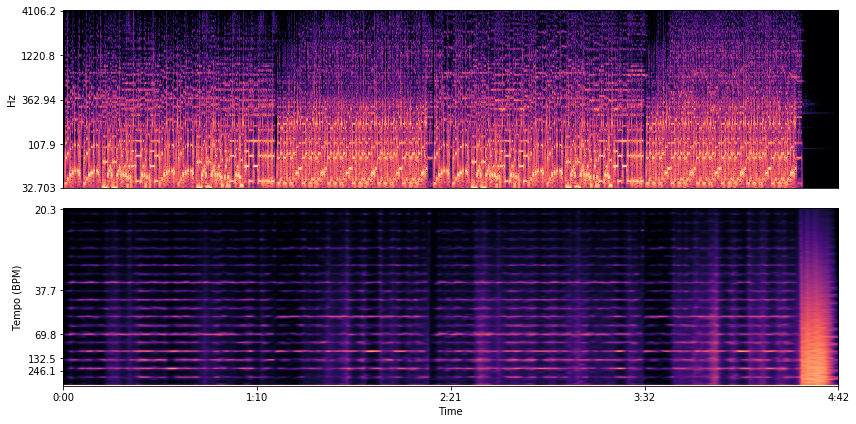

In [26]:
plt.figure(figsize=(12, 6))

plt.subplot(2,1,1)
librosa.display.specshow(C, y_axis='cqt_hz', bins_per_octave=12*3, sr=sr)

plt.subplot(2,1,2)
librosa.display.specshow(tgram[:256], y_axis='tempo', x_axis='time', sr=sr)

plt.tight_layout()

The above figure reveals that the track alternates between sections in 6/8 and 4/4.

In [27]:
# Let's beat-synchronize to reduce dimensionality
tempo, beats = librosa.beat.beat_track(onset_envelope=oenv, sr=sr, trim=False)

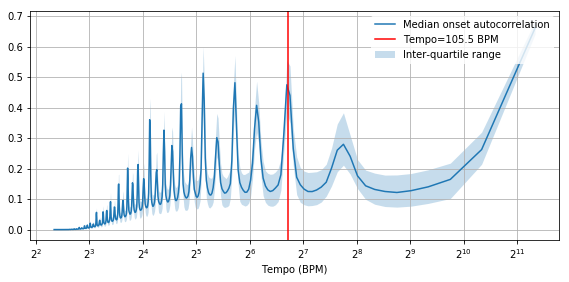

In [28]:
# Let's plot the "average" onset autocorrelation on log-lag axis
# We use the median to suppress outliers / breaks
# We skip over the lag=0 point, since it corresponds to infinite tempo

# Compute the inter-quartile range for each lag position
tlb = np.percentile(tgram[1:], 25, axis=1)
tub = np.percentile(tgram[1:], 75, axis=1)

plt.figure(figsize=(8, 4))
plt.semilogx(librosa.tempo_frequencies(len(tgram))[1:], np.median(tgram[1:], axis=1),
             label='Median onset autocorrelation', basex=2)

plt.fill_between(librosa.tempo_frequencies(len(tgram))[1:], tlb, tub, alpha=0.25,
                 label='Inter-quartile range')

plt.axvline(tempo, color='r', label='Tempo={:.1f} BPM'.format(tempo))
plt.xlabel('Tempo (BPM)')
plt.axis('tight')

plt.grid()
plt.legend(loc='upper right')
plt.tight_layout()

In [29]:
# We can clean up some bleed by a vertical median filter
tgram_clean = np.maximum(0.0, tgram - scipy.ndimage.median_filter(tgram, size=(15, 1)))

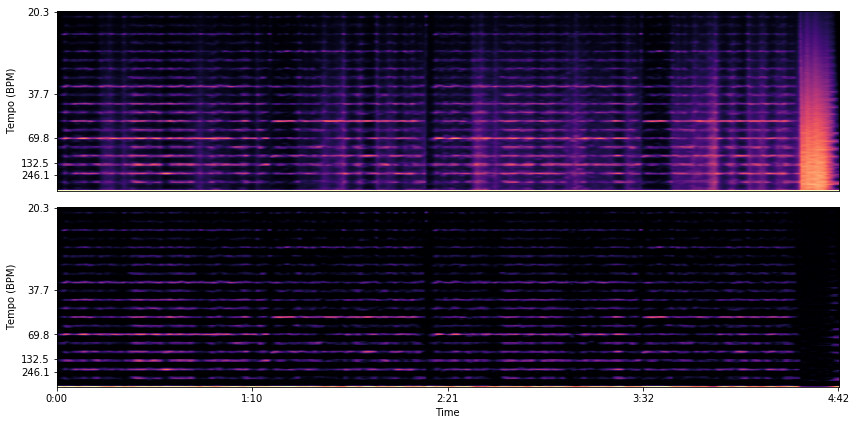

In [30]:
plt.figure(figsize=(12, 6))

plt.subplot(2,1,1)
librosa.display.specshow(tgram[:256], y_axis='tempo', sr=sr)

plt.subplot(2,1,2)
librosa.display.specshow(tgram_clean[:256], y_axis='tempo', x_axis='time', sr=sr)
plt.tight_layout()

In [31]:
tst = librosa.fmt(tgram_clean, axis=0)

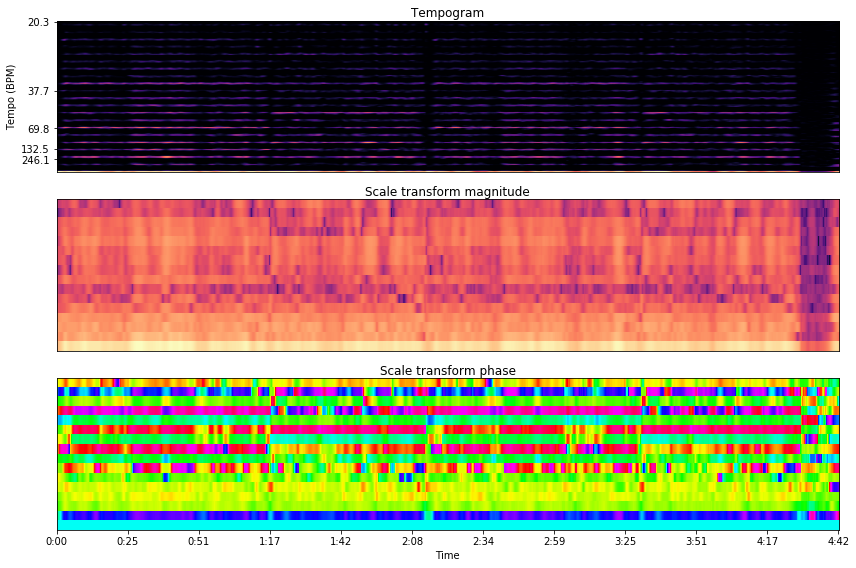

In [32]:
plt.figure(figsize=(12, 8))
plt.subplot(3,1,1)
librosa.display.specshow(tgram_clean[:256], y_axis='tempo', sr=sr)
plt.title('Tempogram')
plt.subplot(3,1,2)
librosa.display.specshow(librosa.logamplitude(tst**2, ref_power=np.max)[:16],  n_xticks=12, sr=sr)
plt.title('Scale transform magnitude')
plt.subplot(3,1,3)
librosa.display.specshow(np.angle(tst)[:16], x_axis='time', n_xticks=12, sr=sr, cmap='hsv')
plt.title('Scale transform phase')
plt.tight_layout()

Examining the first 16 components of the scale transform, some discontinuties show up at around 1:17, 2:10, and 3:30, corresponding to the time signature changes in the track.

In [33]:
tgram_sync = librosa.util.sync(tgram_clean, beats)[1:]
tst_sync = librosa.util.sync(np.abs(tst), beats)[:32]

In [34]:
# And plot a distance matrix for each feature.
Rtgram = scipy.spatial.distance.cdist(tgram_sync.T, tgram_sync.T,
                                      metric='seuclidean', V=1e-3 + np.std(tgram_sync, axis=1))

Rtst = scipy.spatial.distance.cdist(tst_sync.T, tst_sync.T, metric='seuclidean')

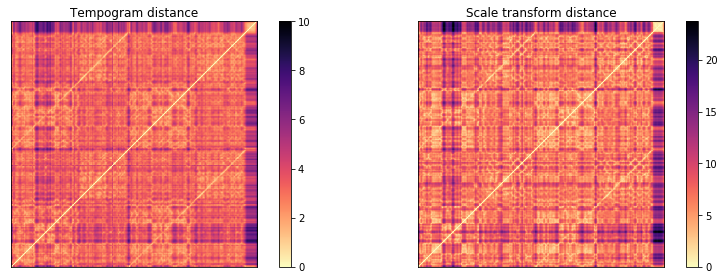

In [35]:
plt.figure(figsize=(12, 4))
plt.subplot(1,2,1)
librosa.display.specshow(Rtgram, cmap='magma_r', aspect='equal')
plt.title('Tempogram distance')
plt.colorbar()

plt.subplot(1,2,2)
librosa.display.specshow(Rtst, cmap='magma_r', aspect='equal')
plt.title('Scale transform distance')
plt.colorbar()
plt.tight_layout()